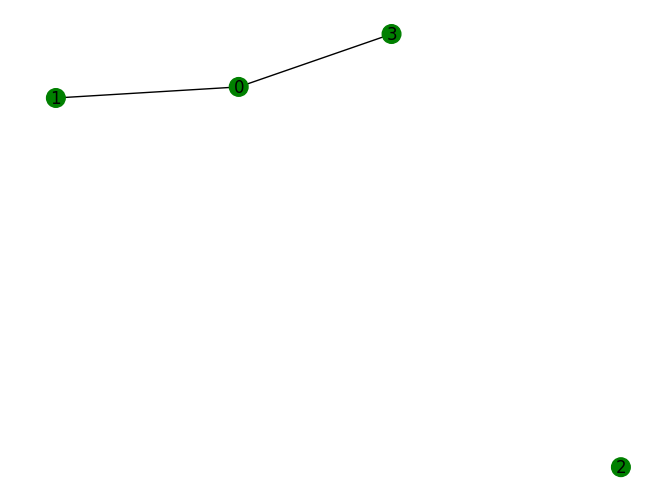

In [60]:
from disqco.circuits.cp_fraction import cp_fraction, cz_fraction
from disqco.graphs.GCP_hypergraph import QuantumCircuitHyperGraph
from qiskit import transpile
from disqco.parti.FM.FM_methods import set_initial_partitions
from disqco.circuits.QAOA import QAOA_random
from qiskit.circuit.library import QFT
import pickle
import numpy as np

num_qubits = 32



num_partitions = 4


qpu_sizes = [int(num_qubits/num_partitions)+1]*num_partitions


coupling = [np.random.choice(range(num_partitions), size = 2, replace = False) for _ in range(num_partitions)]
from disqco.graphs.quantum_network import QuantumNetwork

network = QuantumNetwork(qpu_sizes, coupling)

network.draw()

In [61]:
from disqco.graphs.hypergraph_methods import get_all_costs_hetero, get_all_configs
import time
num_partitions_list = [i+2 for i in range(8)]

time_list = []
for num_partitions in num_partitions_list:
    coupling = [[i, i+1] for i in range(num_partitions-1)]
    qpu_sizes = [1]*num_partitions
    start = time.time()

    configs = get_all_configs(num_partitions)

    network = QuantumNetwork(qpu_sizes, coupling)

    costs = get_all_costs_hetero(network, configs)
    end = time.time()
    time_list.append(end-start)
    print(f"Num Partitions: {num_partitions}, Time: {end-start}")




Num Partitions: 2, Time: 0.00018596649169921875
Num Partitions: 3, Time: 0.0001220703125
Num Partitions: 4, Time: 0.0005319118499755859
Num Partitions: 5, Time: 0.0027179718017578125
Num Partitions: 6, Time: 0.011826038360595703
Num Partitions: 7, Time: 0.05726790428161621
Num Partitions: 8, Time: 0.2877051830291748
Num Partitions: 9, Time: 1.3049278259277344


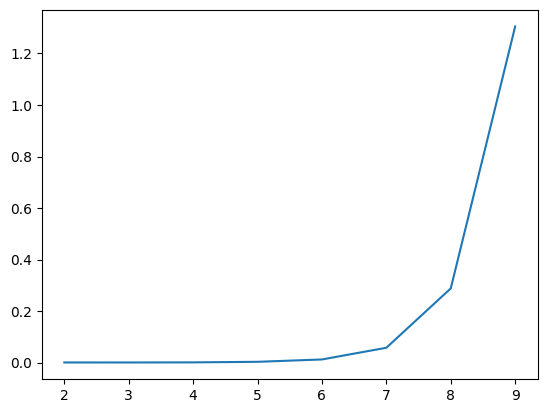

In [62]:

import matplotlib.pyplot as plt

plt.plot(num_partitions_list, time_list)
    

In [63]:
from copy import deepcopy

def coarsen_network(network : QuantumNetwork, desired_size : int = 10):

    network_coarse = deepcopy(network)

    mapping_list = []
    current_mapping = {i : set([i]) for i in range(num_partitions)}

    while len(network_coarse.qpu_graph.nodes) > desired_size:

        exp_sum = sum([np.exp(-network_coarse.qpu_graph.nodes[node]['size']) for node in network_coarse.qpu_graph.nodes])
        probabilities = [np.exp(-network_coarse.qpu_graph.nodes[node]['size'])/exp_sum for node in network_coarse.qpu_graph.nodes]
        node = np.random.choice(list(network_coarse.qpu_graph.nodes), p=probabilities)

        neighbours = list(network_coarse.qpu_graph.neighbors(node))
        if len(neighbours) > 0:
            exp_sum = sum([-np.exp(network_coarse.qpu_graph.nodes[neighbour]['size']) for neighbour in neighbours])
            probabilities = [-np.exp(network_coarse.qpu_graph.nodes[neighbour]['size'])/exp_sum for neighbour in neighbours]
            neighbour = np.random.choice(neighbours, p=probabilities)
            for other_neighbour in neighbours:
                if other_neighbour != neighbour:
                    network_coarse.qpu_graph.add_edge(neighbour, other_neighbour)


            current_mapping[neighbour] = current_mapping[neighbour].union(current_mapping[node])
            del current_mapping[node]
            mapping_list.append(deepcopy(current_mapping))
            
            node_size = network_coarse.qpu_graph.nodes[node]['size']
            network_coarse.qpu_graph.nodes[neighbour]['size'] += node_size
            network_coarse.qpu_graph.remove_node(node)
        else:
            network_coarse.qpu_graph.remove_node(node)
    
    network_coarse.qpu_sizes = [network_coarse.qpu_graph.nodes[node]['size'] for node in network_coarse.qpu_graph.nodes]

    return network_coarse, mapping_list




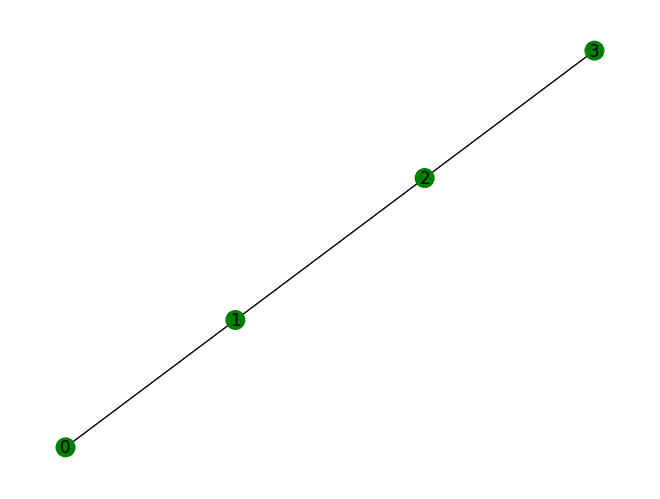

0
0
0
0
1
3
1
1
2
2
1
2
3
2
1
2
1
1
2
2
1
3
2
2
2
3
3
2
2
2
2
3
2
1
1
2
3
3
3
3
3
3
2
3
3
2
1
Initial Cost:  194


In [64]:
from disqco.circuits.cp_fraction import cp_fraction, cz_fraction
from disqco.graphs.GCP_hypergraph import QuantumCircuitHyperGraph
from disqco.graphs.hypergraph_methods import calculate_full_cost_hetero
from qiskit import transpile
from disqco.parti.FM.FM_methods import set_initial_partitions
from disqco.circuits.QAOA import QAOA_random
from qiskit.circuit.library import QFT
import pickle

num_qubits = 32

# circuit = QAOA_random(num_qubits, prob = 0.5, reps = 1)
# circuit = QFT(num_qubits,do_swaps = False)

circuit = cp_fraction(  num_qubits=num_qubits,
                        depth=num_qubits,
                        fraction= 0.5)

# circuit = cz_fraction(  num_qubits=num_qubits,
                        # depth=num_qubits,
                        # fraction= 0.5)


circuit = transpile(circuit, basis_gates = ['cp', 'u'])
depth = circuit.depth()



num_partitions = 4


qpu_sizes = [int(circuit.num_qubits/num_partitions)+1]*num_partitions


coupling = [[i, i+1] for i in range(num_partitions-1)]
from disqco.graphs.quantum_network import QuantumNetwork

network = QuantumNetwork(qpu_sizes, coupling)

network.draw()

graph = QuantumCircuitHyperGraph(circuit, group_gates = True, anti_diag = True)
assignment = set_initial_partitions(qpu_sizes, num_qubits, depth, num_partitions, reduced = True)

initial_cost = calculate_full_cost_hetero(hypergraph=graph, assignment=assignment, num_partitions=num_partitions, costs = {}, network=network)

print("Initial Cost: ", initial_cost)

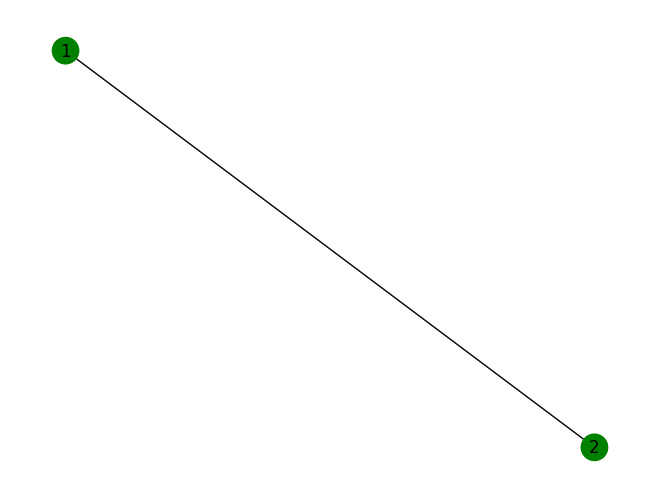

In [65]:
network_coarse, mapping_list = coarsen_network(network, desired_size = 2)
network_coarse.draw()

In [66]:
qpu_sizes_coarse = [network_coarse.qpu_graph.nodes[node]['size'] for node in network_coarse.qpu_graph.nodes]

print(qpu_sizes)

num_partitions_coarse = len(qpu_sizes_coarse)

node_map = {i : node for i, node in enumerate(network_coarse.qpu_graph.nodes)}

print(node_map)

[9, 9, 9, 9]
{0: 1, 1: 2}


In [67]:
configs_coarse = get_all_configs(num_partitions_coarse)


costs_coarse, edge_tree = get_all_costs_hetero(network_coarse, configs_coarse, node_map = node_map)


print(costs)

assignment_coarse = set_initial_partitions(qpu_sizes_coarse, num_qubits, depth, num_partitions_coarse, reduced = True)

({((0, 0, 0, 0, 0, 0, 0, 0, 0), (0, 0, 0, 0, 0, 0, 0, 0, 0)): 0, ((0, 0, 0, 0, 0, 0, 0, 0, 0), (0, 0, 0, 0, 0, 0, 0, 0, 1)): 0, ((0, 0, 0, 0, 0, 0, 0, 0, 0), (0, 0, 0, 0, 0, 0, 0, 1, 0)): 0, ((0, 0, 0, 0, 0, 0, 0, 0, 0), (0, 0, 0, 0, 0, 0, 0, 1, 1)): 0, ((0, 0, 0, 0, 0, 0, 0, 0, 0), (0, 0, 0, 0, 0, 0, 1, 0, 0)): 0, ((0, 0, 0, 0, 0, 0, 0, 0, 0), (0, 0, 0, 0, 0, 0, 1, 0, 1)): 0, ((0, 0, 0, 0, 0, 0, 0, 0, 0), (0, 0, 0, 0, 0, 0, 1, 1, 0)): 0, ((0, 0, 0, 0, 0, 0, 0, 0, 0), (0, 0, 0, 0, 0, 0, 1, 1, 1)): 0, ((0, 0, 0, 0, 0, 0, 0, 0, 0), (0, 0, 0, 0, 0, 1, 0, 0, 0)): 0, ((0, 0, 0, 0, 0, 0, 0, 0, 0), (0, 0, 0, 0, 0, 1, 0, 0, 1)): 0, ((0, 0, 0, 0, 0, 0, 0, 0, 0), (0, 0, 0, 0, 0, 1, 0, 1, 0)): 0, ((0, 0, 0, 0, 0, 0, 0, 0, 0), (0, 0, 0, 0, 0, 1, 0, 1, 1)): 0, ((0, 0, 0, 0, 0, 0, 0, 0, 0), (0, 0, 0, 0, 0, 1, 1, 0, 0)): 0, ((0, 0, 0, 0, 0, 0, 0, 0, 0), (0, 0, 0, 0, 0, 1, 1, 0, 1)): 0, ((0, 0, 0, 0, 0, 0, 0, 0, 0), (0, 0, 0, 0, 0, 1, 1, 1, 0)): 0, ((0, 0, 0, 0, 0, 0, 0, 0, 0), (0, 0, 0, 0, 0, 1, 1, 1

In [68]:
from disqco.parti.FM.multilevel_FM import MLFM_recursive_hetero

final_assignment_list_coarse, cost_list_coarse, time_list_coarse = MLFM_recursive_hetero(
    graph,
    assignment_coarse,
    qpu_sizes_coarse,
    limit=num_qubits,
    network=network_coarse,
    node_map=node_map,
    log=True,
    stochastic=True)


Initial cost: 79
All passes complete.
Final cost: 48
Best cost at level 0: 48
Initial cost: 48
All passes complete.
Final cost: 45
Best cost at level 1: 45
Initial cost: 45
All passes complete.
Final cost: 43
Best cost at level 2: 43
Initial cost: 43
All passes complete.
Final cost: 41
Best cost at level 3: 41
Initial cost: 41
All passes complete.
Final cost: 40
Best cost at level 4: 40
Initial cost: 40
All passes complete.
Final cost: 39
Best cost at level 5: 39


In [69]:
print(mapping_list[-1])

print(qpu_sizes)

print(qpu_sizes_coarse)

final_assignment_coarse = final_assignment_list_coarse[np.argmin(cost_list_coarse)]
for layer in final_assignment_coarse:
    print(layer)

{1: {0, 1}, 2: {2, 3}}
[9, 9, 9, 9]
[18, 18]
[1 0 0 1 1 0 1 1 0 1 1 1 1 0 1 1 0 1 0 1 0 0 1 0 1 1 0 1 1 0 0 0]
[1 0 0 1 1 0 1 1 0 1 1 1 1 0 1 1 0 1 0 1 0 0 1 0 1 1 0 1 1 0 0 0]
[1 0 0 1 1 0 1 1 0 1 1 1 1 0 1 1 0 1 0 1 0 0 1 0 1 1 0 1 1 0 0 0]
[1 0 0 1 1 0 0 1 0 1 1 1 0 0 1 1 0 1 0 1 0 0 1 0 1 1 0 1 1 0 1 0]
[1 0 0 1 1 0 0 1 0 1 1 1 0 0 1 1 0 1 0 1 0 0 1 0 1 1 0 1 1 0 1 0]
[1 0 0 1 1 0 0 1 0 1 1 1 0 0 1 1 0 1 0 1 0 0 1 0 1 1 0 1 1 0 1 0]
[1 0 0 1 1 0 0 1 0 1 1 1 0 0 1 1 0 1 0 1 0 0 1 0 1 1 0 1 1 0 1 0]
[1 0 1 1 1 0 0 1 0 1 1 1 0 0 1 1 0 1 0 1 0 0 1 0 1 1 0 1 1 0 1 0]
[1 0 1 1 1 0 0 1 0 1 1 1 0 0 1 1 0 1 0 1 0 0 1 0 1 1 0 1 1 0 1 0]
[1 0 1 1 1 0 0 1 0 1 1 1 0 0 1 1 0 1 0 1 0 0 1 0 1 1 0 1 1 0 1 0]
[1 0 1 1 1 0 0 1 0 1 1 1 0 0 1 1 0 1 0 1 0 0 1 0 0 1 0 1 1 0 1 0]
[1 0 1 1 1 0 0 1 0 1 1 1 0 0 1 1 0 1 0 1 0 0 1 0 0 1 0 1 1 0 1 0]
[1 0 1 1 1 0 0 1 0 1 1 1 0 0 1 1 0 1 0 1 0 0 1 0 0 1 0 1 1 0 1 0]
[1 0 1 1 1 0 0 1 0 1 1 1 0 0 1 1 0 1 0 1 0 0 1 0 0 1 0 1 1 0 1 0]
[1 0 1 1 1 0 0 1 0 1 1 1 0 0 1 

In [70]:
def transform_assignemnt(assignment, mapping, qpu_sizes, qpu_sizes_coarse, node_map):
    new_assignment = deepcopy(assignment)
    mapping_list_sizes_base = {}
    for qpu_coarse in mapping:
        contained_qpus = mapping[qpu_coarse]
        mapping_list_sizes_base[qpu_coarse] = {}
        for qpu in contained_qpus:
            mapping_list_sizes_base[qpu_coarse][qpu] = qpu_sizes[qpu]   
    for t in range(len(assignment)):
        mapping_list_sizes = deepcopy(mapping_list_sizes_base)
        for q in range(len(assignment[t])):
            coarse_qpu = assignment[t][q]
            print(coarse_qpu)
            fine_qpu = node_map[coarse_qpu]
            options = mapping_list_sizes[fine_qpu]
            print(options)
            for choice in options:
                print(choice)
                print(mapping_list_sizes[fine_qpu][choice])
                if mapping_list_sizes[fine_qpu][choice] > 0:
                    new_assignment[t][q] = choice
                    print(new_assignment[t])
                    mapping_list_sizes[fine_qpu][choice] -= 1
                    if mapping_list_sizes[fine_qpu][choice] == 0:
                        del mapping_list_sizes[fine_qpu][choice]
                break
    return new_assignment





# print(mapping_list[-1])

assignment_uncoarsened = transform_assignemnt(final_assignment_coarse, mapping_list[-1], qpu_sizes, qpu_sizes_coarse, node_map)

for layer in assignment_uncoarsened:
    print("Layer", layer)

1
{2: 9, 3: 9}
2
9
[2 0 0 1 1 0 1 1 0 1 1 1 1 0 1 1 0 1 0 1 0 0 1 0 1 1 0 1 1 0 0 0]
0
{0: 9, 1: 9}
0
9
[2 0 0 1 1 0 1 1 0 1 1 1 1 0 1 1 0 1 0 1 0 0 1 0 1 1 0 1 1 0 0 0]
0
{0: 8, 1: 9}
0
8
[2 0 0 1 1 0 1 1 0 1 1 1 1 0 1 1 0 1 0 1 0 0 1 0 1 1 0 1 1 0 0 0]
1
{2: 8, 3: 9}
2
8
[2 0 0 2 1 0 1 1 0 1 1 1 1 0 1 1 0 1 0 1 0 0 1 0 1 1 0 1 1 0 0 0]
1
{2: 7, 3: 9}
2
7
[2 0 0 2 2 0 1 1 0 1 1 1 1 0 1 1 0 1 0 1 0 0 1 0 1 1 0 1 1 0 0 0]
0
{0: 7, 1: 9}
0
7
[2 0 0 2 2 0 1 1 0 1 1 1 1 0 1 1 0 1 0 1 0 0 1 0 1 1 0 1 1 0 0 0]
1
{2: 6, 3: 9}
2
6
[2 0 0 2 2 0 2 1 0 1 1 1 1 0 1 1 0 1 0 1 0 0 1 0 1 1 0 1 1 0 0 0]
1
{2: 5, 3: 9}
2
5
[2 0 0 2 2 0 2 2 0 1 1 1 1 0 1 1 0 1 0 1 0 0 1 0 1 1 0 1 1 0 0 0]
0
{0: 6, 1: 9}
0
6
[2 0 0 2 2 0 2 2 0 1 1 1 1 0 1 1 0 1 0 1 0 0 1 0 1 1 0 1 1 0 0 0]
1
{2: 4, 3: 9}
2
4
[2 0 0 2 2 0 2 2 0 2 1 1 1 0 1 1 0 1 0 1 0 0 1 0 1 1 0 1 1 0 0 0]
1
{2: 3, 3: 9}
2
3
[2 0 0 2 2 0 2 2 0 2 2 1 1 0 1 1 0 1 0 1 0 0 1 0 1 1 0 1 1 0 0 0]
1
{2: 2, 3: 9}
2
2
[2 0 0 2 2 0 2 2 0 2 2 2 1 0 1 1 0 1 0 1 0 0 1

In [71]:
from disqco.parti.FM.FM_methods import calculate_full_cost_hetero
costs = {}
cost = calculate_full_cost_hetero(graph, assignment_uncoarsened, num_partitions, costs, network)
print(cost)

0
0
2
2
0
1
1
1
0
1
2
2
1
1
2
1
0
2
0
3
3
1
1
1
3
2
3
3
2
2
2
2
2
3
3
2
2
2
2
2
1
1
2
164


In [72]:
for layer in final_assignment_coarse:
    print("Layer", layer)

print("Num partitions coarse: ", num_partitions_coarse)
cost = calculate_full_cost_hetero(graph, final_assignment_coarse, num_partitions_coarse, {}, network_coarse)
print(cost)

def remove_nl_edges(graph : QuantumCircuitHyperGraph, assignment :list[list[int]]):
    discarded = {}
    edges_to_discard = set()
    for edge in graph.hyperedges:
        root_q = edge[0]
        edge_info = graph.hyperedges[edge]
        root_set = edge_info['root_set']
        rec_set = edge_info['receiver_set']
        
        root_assignment_set = set()
        t_max = 0
        for node in root_set:
            root_part = assignment[node[1]][node[0]]
            root_assignment_set.add(root_part)
            t = node[1]
            if t > t_max:
                t_max = t
        info = {'roots_discarded' : set(), 'recs_discarded' : set()}
        recs_to_discard = set()
        roots_to_discard = set()
        for node in rec_set:
            rec_part = assignment[node[1]][node[0]]
            if rec_part not in root_assignment_set:
                print("Non-local")
                if node[1] == t_max:
                    # If node is last in group, shrink the group in time.
                    roots_to_discard.add((root_q, t_max))
                    info['roots_discarded'].add((root_q, t_max))
                    

                recs_to_discard.add(node)
                info['recs_discarded'].add(node)

        for node in roots_to_discard:
            root_set.discard(node)
        for node in recs_to_discard:
            rec_set.discard(node)

        if len(rec_set) == 0:
            edges_to_discard.add(edge)
            
        discarded[edge] = info

    for edge in edges_to_discard:
        graph.remove_hyperedge(edge)
    return discarded
    
discarded = remove_nl_edges(graph, assignment_coarse)



Layer [1 0 0 1 1 0 1 1 0 1 1 1 1 0 1 1 0 1 0 1 0 0 1 0 1 1 0 1 1 0 0 0]
Layer [1 0 0 1 1 0 1 1 0 1 1 1 1 0 1 1 0 1 0 1 0 0 1 0 1 1 0 1 1 0 0 0]
Layer [1 0 0 1 1 0 1 1 0 1 1 1 1 0 1 1 0 1 0 1 0 0 1 0 1 1 0 1 1 0 0 0]
Layer [1 0 0 1 1 0 0 1 0 1 1 1 0 0 1 1 0 1 0 1 0 0 1 0 1 1 0 1 1 0 1 0]
Layer [1 0 0 1 1 0 0 1 0 1 1 1 0 0 1 1 0 1 0 1 0 0 1 0 1 1 0 1 1 0 1 0]
Layer [1 0 0 1 1 0 0 1 0 1 1 1 0 0 1 1 0 1 0 1 0 0 1 0 1 1 0 1 1 0 1 0]
Layer [1 0 0 1 1 0 0 1 0 1 1 1 0 0 1 1 0 1 0 1 0 0 1 0 1 1 0 1 1 0 1 0]
Layer [1 0 1 1 1 0 0 1 0 1 1 1 0 0 1 1 0 1 0 1 0 0 1 0 1 1 0 1 1 0 1 0]
Layer [1 0 1 1 1 0 0 1 0 1 1 1 0 0 1 1 0 1 0 1 0 0 1 0 1 1 0 1 1 0 1 0]
Layer [1 0 1 1 1 0 0 1 0 1 1 1 0 0 1 1 0 1 0 1 0 0 1 0 1 1 0 1 1 0 1 0]
Layer [1 0 1 1 1 0 0 1 0 1 1 1 0 0 1 1 0 1 0 1 0 0 1 0 0 1 0 1 1 0 1 0]
Layer [1 0 1 1 1 0 0 1 0 1 1 1 0 0 1 1 0 1 0 1 0 0 1 0 0 1 0 1 1 0 1 0]
Layer [1 0 1 1 1 0 0 1 0 1 1 1 0 0 1 1 0 1 0 1 0 0 1 0 0 1 0 1 1 0 1 0]
Layer [1 0 1 1 1 0 0 1 0 1 1 1 0 0 1 1 0 1 0 1 0 0 1 0 0 1 0 1 1

KeyError: 0

In [ ]:
for edge in discarded:
    if discarded[edge]['recs_discarded'] != set():
        print("Edge", edge, "Discarded roots", discarded[edge]['recs_discarded'])

Edge (18, 2) Discarded roots {(19, 2), (28, 8)}
